In [1]:
import pickle
import cv2
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
import glob
from moviepy.editor import VideoFileClip
from IPython.display import HTML
% matplotlib inline
import imageio

Calibrate and Visualize findings to assert correctness

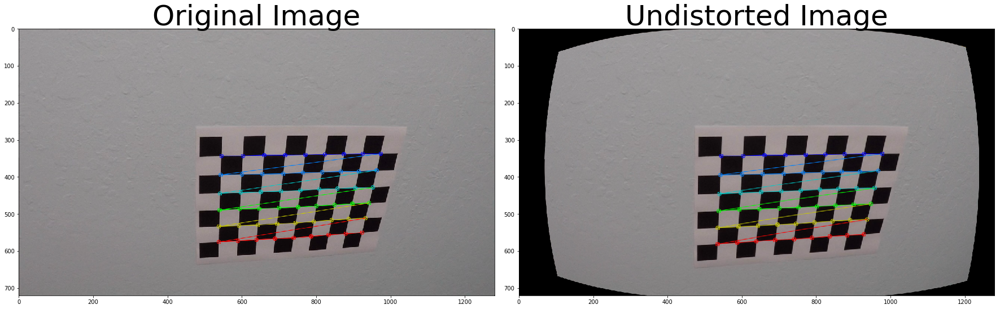

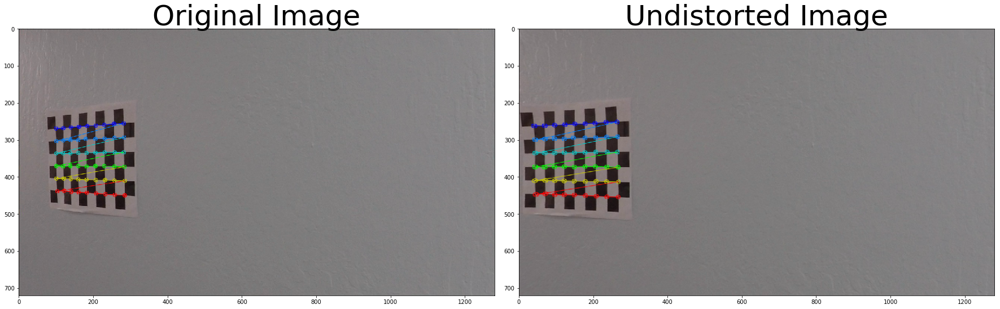

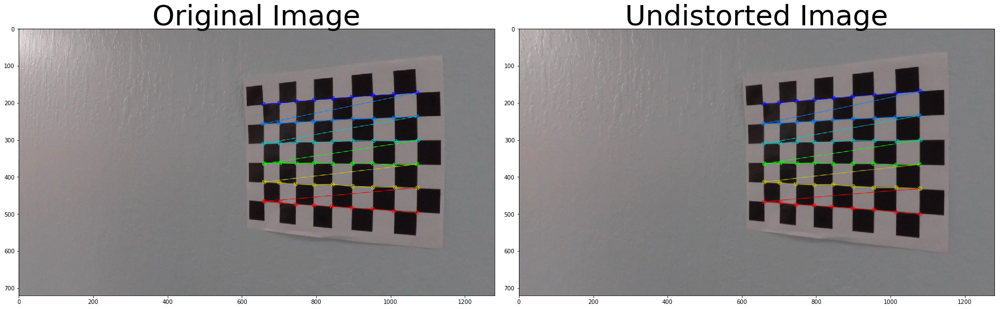

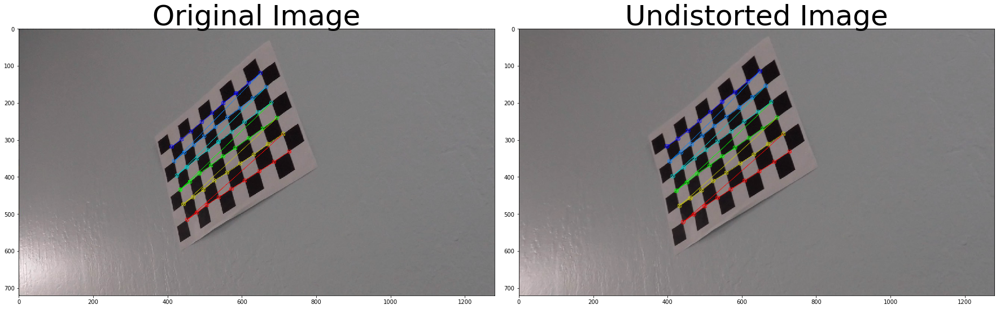

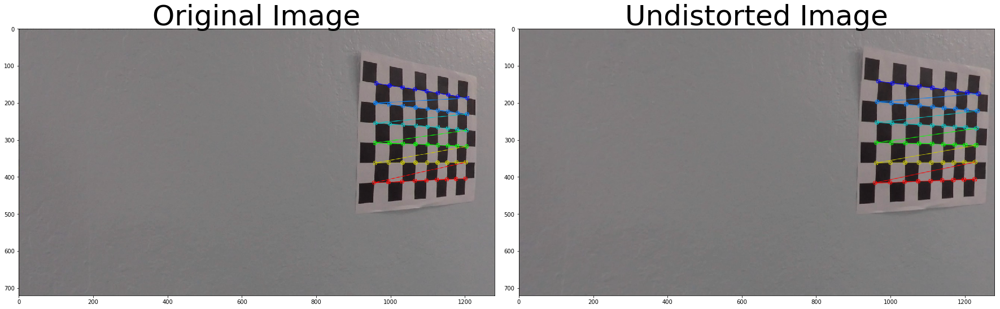

...

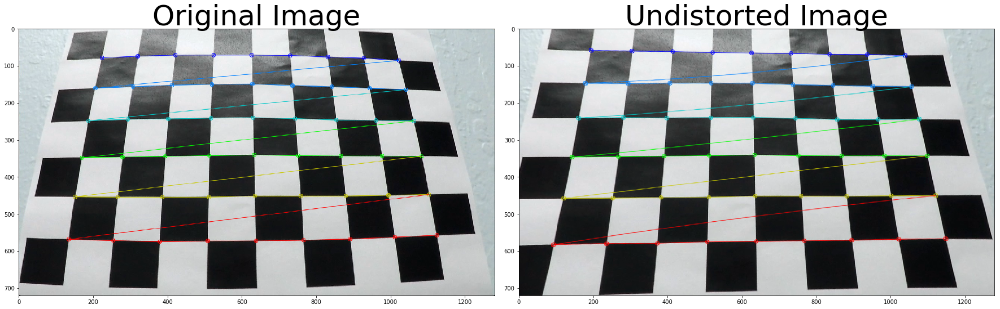

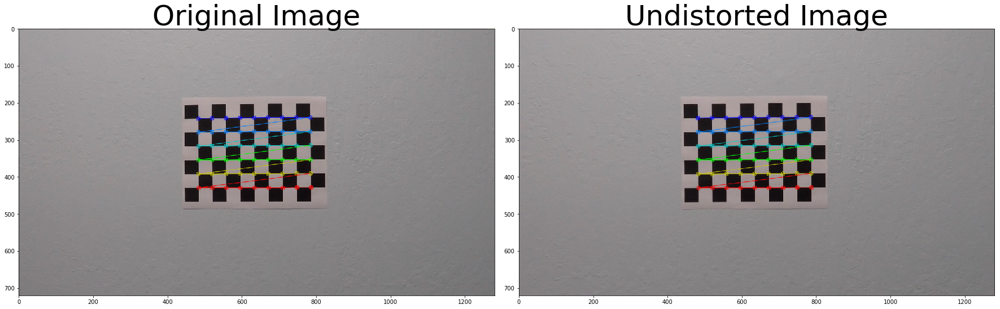

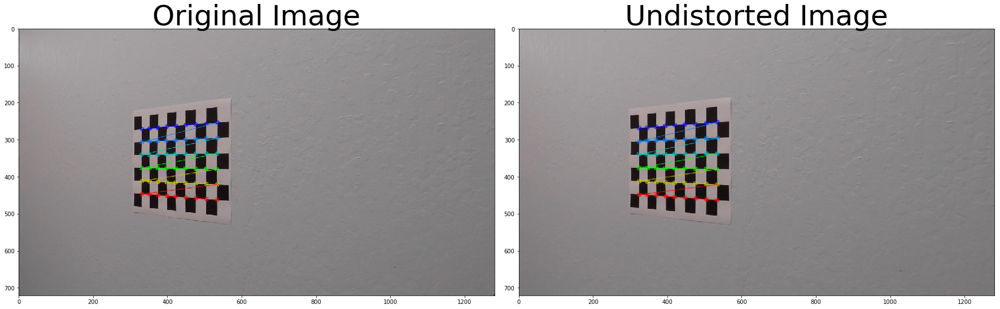

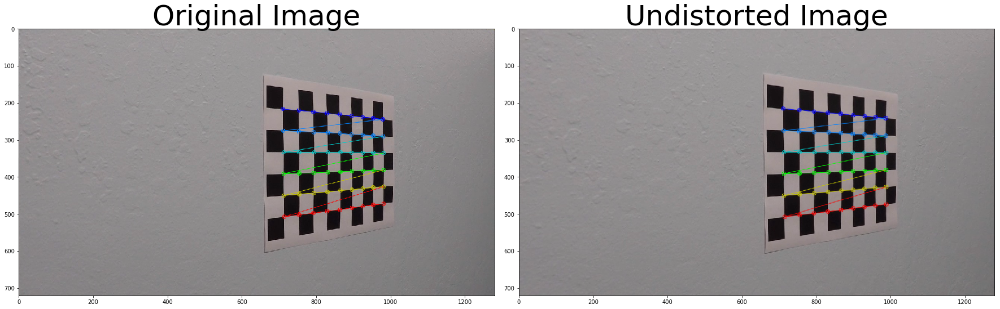

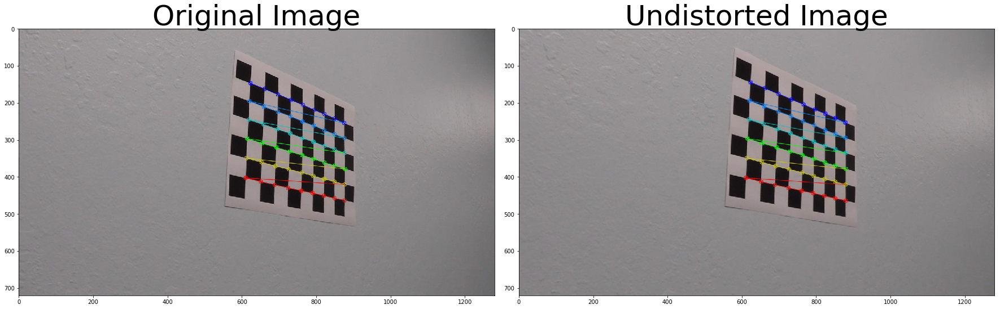

In [2]:
# Read calibration images
cal_image_list = glob.glob('camera_cal/*.jpg') #assuming jpg

 # Prepare object points
objpoints = []
imgpoints = []
nx = 9 # Number of columns
ny = 6 # Number of rows
objp = np.zeros((nx*ny,3),np.float32)
objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)

for img_path in cal_image_list:    
    img = cv2.imread(img_path)
    gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
    # Find the chessboard corners
    ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
    # If corners found, add object and image points
    if ret == True:
        imgpoints.append(corners)
        objpoints.append(objp)
        
        # Draw corners
        cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
        # Find coefficients
        ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
        # Undistort
        undistorted = cv2.undistort(img, mtx, dist, None, mtx)
        # Store them in the folder
        #cv2.imwrite('output_images/'+img_path.split('\\')[-1].split('.')[0]+'_undst_draw_corners.jpg',undistorted)
        
        # Plot the original and the undistorted image
        f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
        f.tight_layout()
        ax1.imshow(img)
        ax1.set_title('Original Image', fontsize=50)
        ax2.imshow(undistorted)
        ax2.set_title('Undistorted Image', fontsize=50)
        plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
        # Store them
        plt.savefig('output_images/calibration/'+img_path.split('\\')[-1].split('.')[0]+'_undst_draw_corners.jpg')


Now generalize the algorithm for ease of use

In [3]:
def calibrate_camera(cal_image_list,nx,ny, draw_corners=False):
    # Prepare object points
    objpoints = []
    imgpoints = []
    nx = 9 # Number of columns
    ny = 6 # Number of rows
    objp = np.zeros((nx*ny,3),np.float32)
    objp[:,:2] = np.mgrid[0:nx,0:ny].T.reshape(-1,2)
    
    for img_path in cal_image_list:
        img = cv2.imread(img_path)
        gray = cv2.cvtColor(img,cv2.COLOR_BGR2GRAY)
        # Find the chessboard corners
        ret, corners = cv2.findChessboardCorners(gray, (nx, ny), None)
        # If corners found, add object and image points
        if ret == True:
            imgpoints.append(corners)
            objpoints.append(objp)
            # Draw corners
            if draw_corners:
                cv2.drawChessboardCorners(img, (nx, ny), corners, ret)
            
    # Find coefficients
    ret, mtx, dist, rvecs, tvecs = cv2.calibrateCamera(objpoints, imgpoints, gray.shape[::-1], None, None)
    return mtx,dist

def initialize_camera_calibration():
    cal_image_list = glob.glob('camera_cal/*.jpg') #assuming jpg
    nx, ny = 9, 6
    mtx, dist = calibrate_camera(cal_image_list, nx, ny,draw_corners=True)
    return mtx, dist

# Find and store coefficients
mtx, dist = initialize_camera_calibration()
# Save the camera calibration result for later use
dist_pickle = {}
dist_pickle["mtx"] = mtx
dist_pickle["dist"] = dist
pickle.dump( dist_pickle, open( "output_images/wide_dist_pickle.p", "wb" ) )

Test calibration with test images from the road


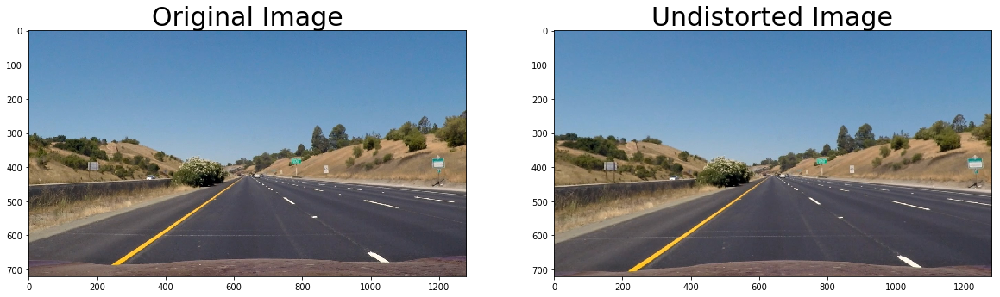

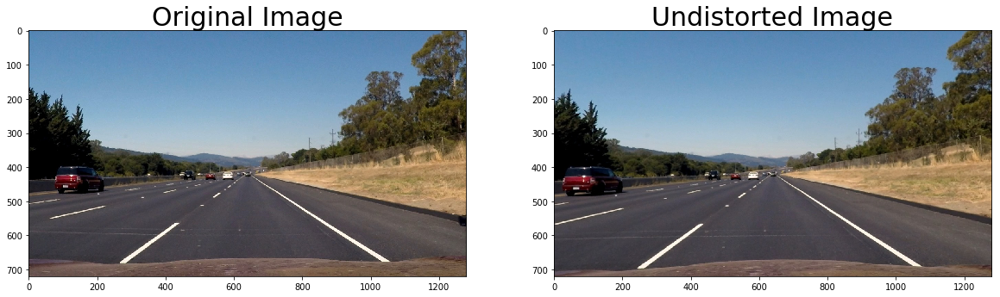

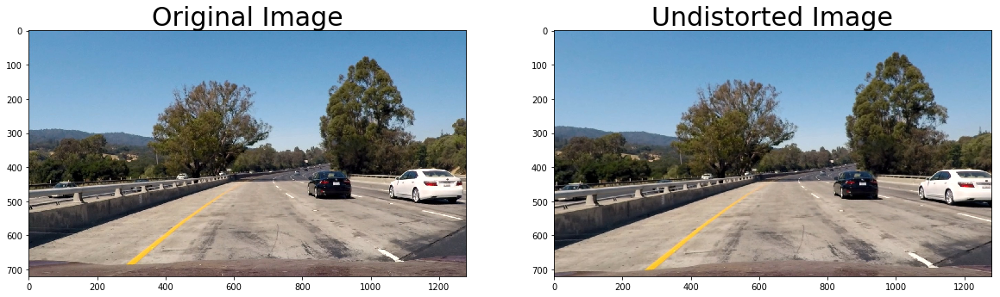

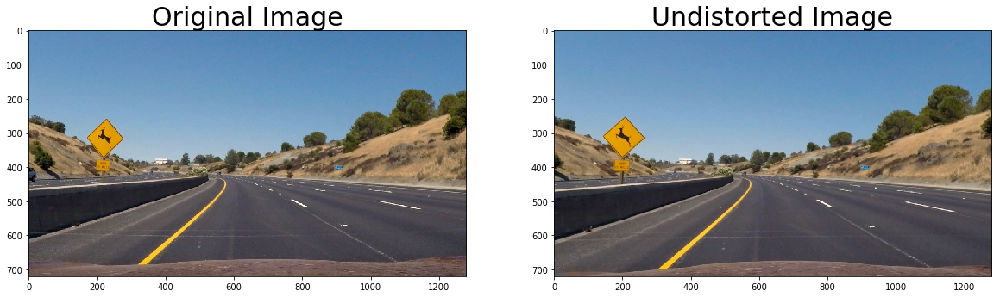

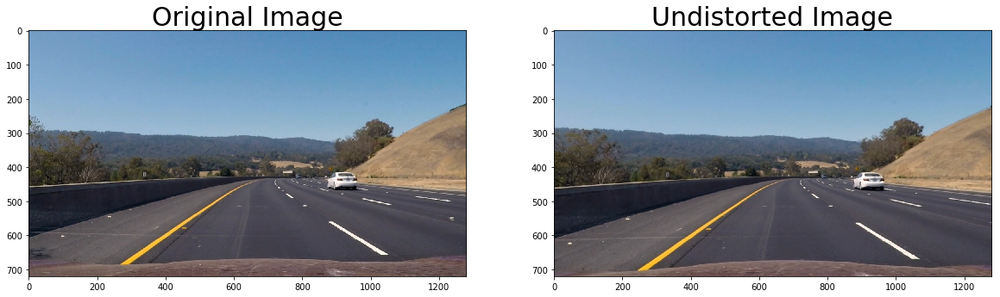

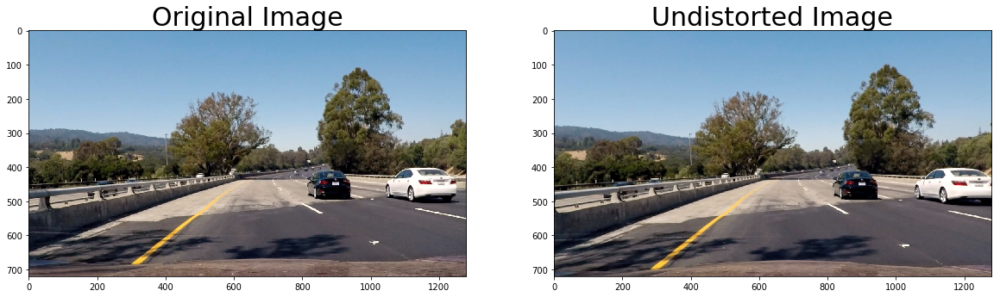

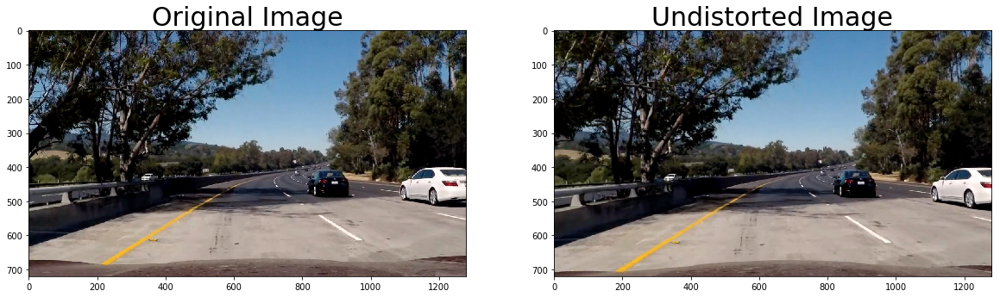

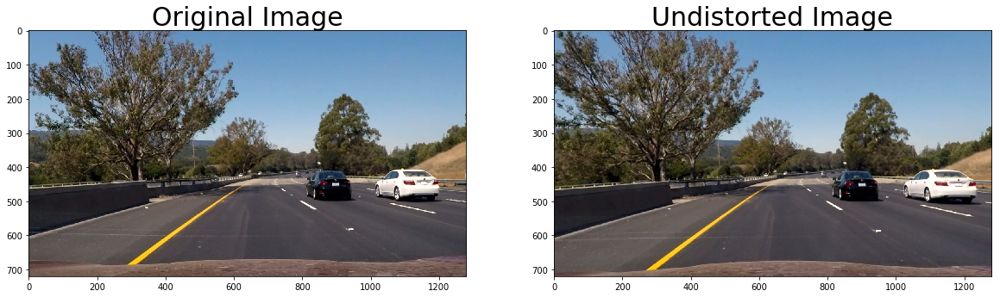

In [4]:
# Read test images
test_image_list = glob.glob('test_images/*.jpg') #assuming jpg
# A list with the undistorted test images
undistorted_test_images = []

for img_path in test_image_list:
    img = cv2.imread(img_path)
    img_size = (img.shape[1], img.shape[0])
    # Undistort images
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    # Append to list
    undistorted_test_images.append(undistorted)
    # Store them in the folder
    #cv2.imwrite('output_images/'+img_path.split('\\')[-1].split('.')[0]+'_undst.jpg',undistorted)    
    
    # Convert to RGB for visualization
    undistorted = cv2.cvtColor(undistorted, cv2.COLOR_BGR2RGB)
    # Visualize undistortion
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(20,10))
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=30)
    ax2.imshow(undistorted)
    ax2.set_title('Undistorted Image', fontsize=30)
    # Store them
    plt.savefig('output_images/undistorted test images/'+img_path.split('\\')[-1].split('.')[0]+'_undst.jpg')

Try different gradient thresholding techniques and combine to create a binary image

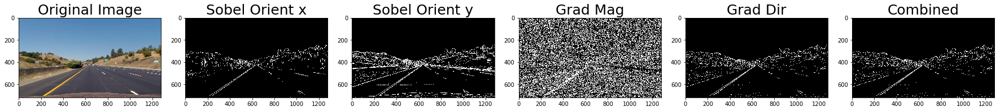

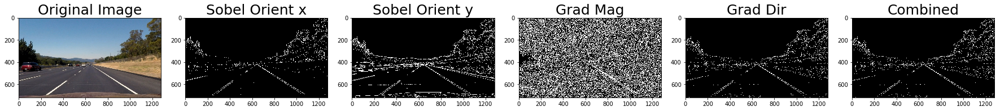

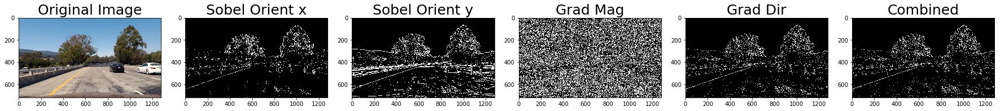

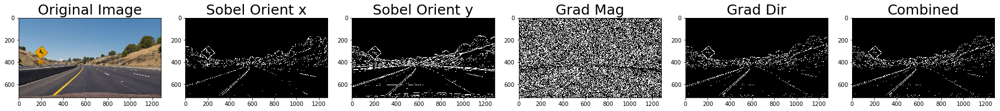

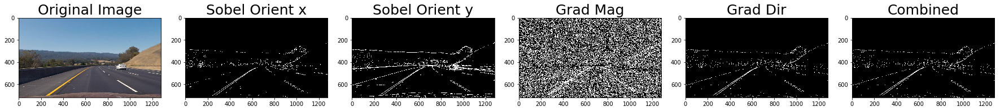

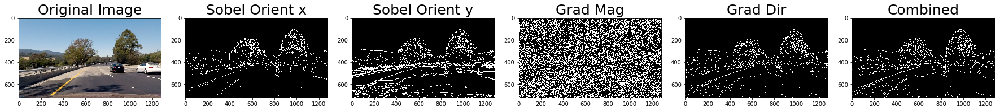

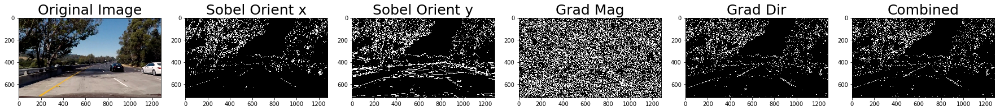

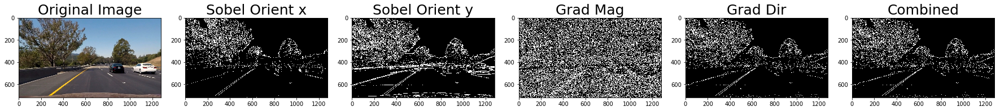

In [5]:
def abs_sobel_thresh(img, orient='x', sobel_kernel=3, thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(img, cv2.COLOR_RGB2GRAY)
    # Apply x or y gradient with the OpenCV Sobel() function
    # and take the absolute value
    if orient == 'x':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 1, 0))
    if orient == 'y':
        abs_sobel = np.absolute(cv2.Sobel(gray, cv2.CV_64F, 0, 1))
    # Rescale back to 8 bit integer
    scaled_sobel = np.uint8(255*abs_sobel/np.max(abs_sobel))
    # Create a copy and apply the threshold
    grad_binary = np.zeros_like(scaled_sobel)
    grad_binary[(scaled_sobel >= thresh[0]) & (scaled_sobel <= thresh[1])] = 1

    return grad_binary

def mag_thresh(image, sobel_kernel=3, mag_thresh=(0, 255)):
    # Convert to grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # Take both Sobel x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Calculate the gradient magnitude
    gradmag = np.sqrt(sobelx**2 + sobely**2)
    # Rescale to 8 bit
    scale_factor = np.max(gradmag)/255 
    gradmag = (gradmag/scale_factor).astype(np.uint8) 
    # Create a binary image of ones where threshold is met, zeros otherwise
    mag_binary = np.zeros_like(gradmag)
    mag_binary[(gradmag >= mag_thresh[0]) & (gradmag <= mag_thresh[1])] = 1

    return mag_binary

def dir_threshold(image, sobel_kernel=3, thresh=(0, np.pi/2)):
    # Grayscale
    gray = cv2.cvtColor(image, cv2.COLOR_RGB2GRAY)
    # Calculate the x and y gradients
    sobelx = cv2.Sobel(gray, cv2.CV_64F, 1, 0, ksize=sobel_kernel)
    sobely = cv2.Sobel(gray, cv2.CV_64F, 0, 1, ksize=sobel_kernel)
    # Take the absolute value of the gradient direction, 
    # apply a threshold, and create a binary image result
    absgraddir = np.arctan2(np.absolute(sobely), np.absolute(sobelx))
    dir_binary =  np.zeros_like(absgraddir)
    dir_binary[(absgraddir >= thresh[0]) & (absgraddir <= thresh[1])] = 1
    return dir_binary

def grad_combined(image,sobel_kernel=3):
    gradx = abs_sobel_thresh(image, orient='x', sobel_kernel=sobel_kernel, thresh=(25, 100))
    grady = abs_sobel_thresh(image, orient='y', sobel_kernel=sobel_kernel, thresh=(20, 150))
    mag_binary = mag_thresh(image, sobel_kernel=sobel_kernel, mag_thresh=(20, 120))
    dir_binary = dir_threshold(image, sobel_kernel=sobel_kernel, thresh=(0.7, 1.3))
    combined = np.zeros_like(gradx)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    return combined

ksize = 3
for img in undistorted_test_images:
    gradx = abs_sobel_thresh(img, orient='x', sobel_kernel=ksize, thresh=(25, 100))
    grady = abs_sobel_thresh(img, orient='y', sobel_kernel=ksize, thresh=(20, 150))
    mag_binary = mag_thresh(img, sobel_kernel=ksize, mag_thresh=(20, 120))
    dir_binary = dir_threshold(img, sobel_kernel=ksize, thresh=(0.7, 1.3))
    combined = np.zeros_like(gradx)
    combined[((gradx == 1) & (grady == 1)) | ((mag_binary == 1) & (dir_binary == 1))] = 1
    # Visualize undistortion
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    # Plot the result
    f, (ax1, ax2, ax3, ax4, ax5, ax6) = plt.subplots(1, 6, figsize=(24, 9))
    f.tight_layout()
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(gradx, cmap='gray')
    ax2.set_title('Sobel Orient x', fontsize=25)
    ax3.imshow(grady, cmap='gray')
    ax3.set_title('Sobel Orient y', fontsize=25)    
    ax4.imshow(dir_binary, cmap='gray')
    ax4.set_title('Grad Mag', fontsize=25)   
    ax5.imshow(combined, cmap='gray')
    ax5.set_title('Grad Dir', fontsize=25)    
    ax6.imshow(combined, cmap='gray')
    ax6.set_title('Combined', fontsize=25)
    plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

Apply HLS color transformation and thresholding

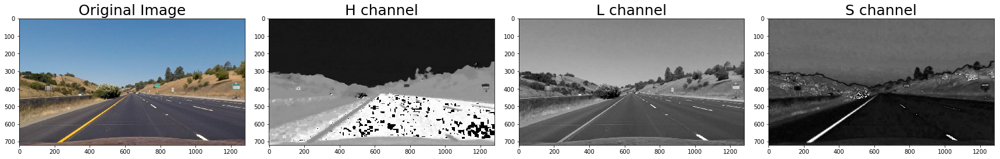

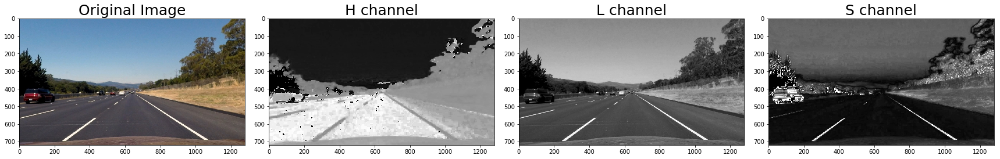

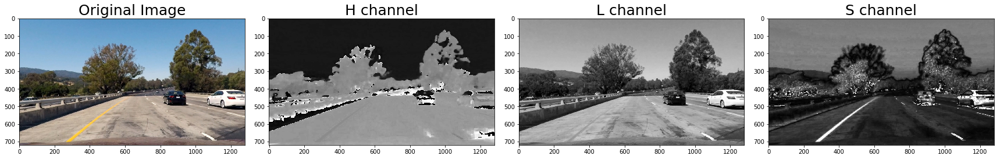

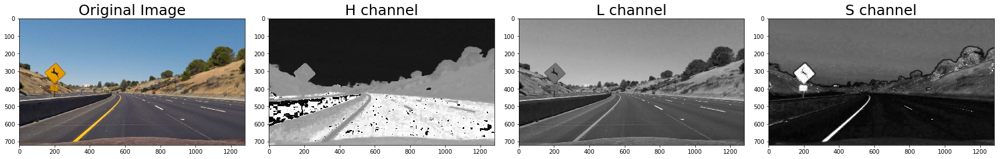

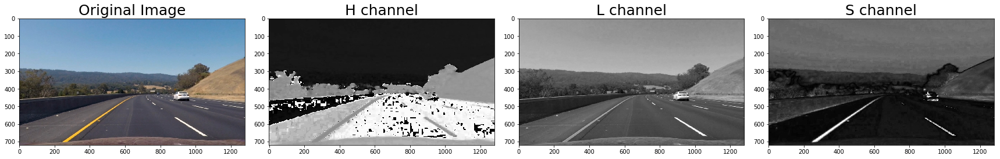

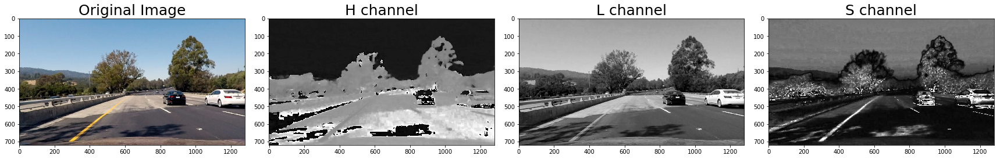

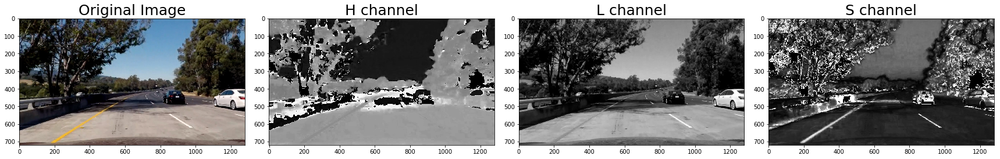

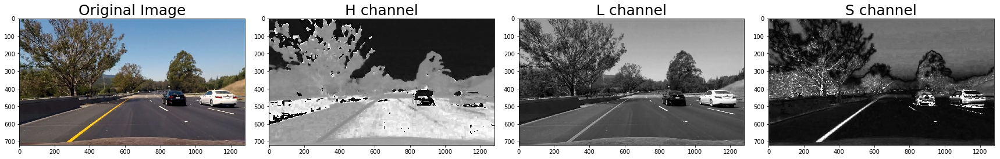

In [6]:
# Visualize how H L S channels performs
for img in undistorted_test_images:
    hsv = cv2.cvtColor(img, cv2.COLOR_RGB2HLS).astype(np.float)
    h_channel = hsv[:,:,0]
    l_channel = hsv[:,:,1]
    s_channel = hsv[:,:,2]
    # Plot the result
    f, (ax1, ax2, ax3, ax4) = plt.subplots(1, 4, figsize=(24, 9))
    f.tight_layout()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(h_channel, cmap='gray')
    ax2.set_title('H channel', fontsize=25)
    ax3.imshow(l_channel, cmap='gray')
    ax3.set_title('L channel', fontsize=25)
    ax4.imshow(s_channel, cmap='gray')
    ax4.set_title('S channel', fontsize=25)



Use S channel info and apply threshold

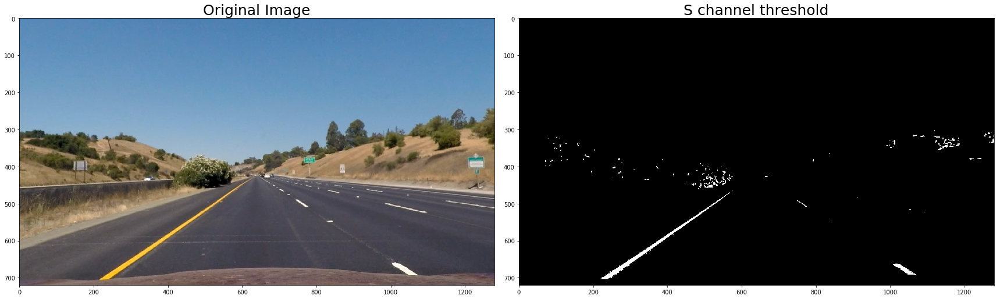

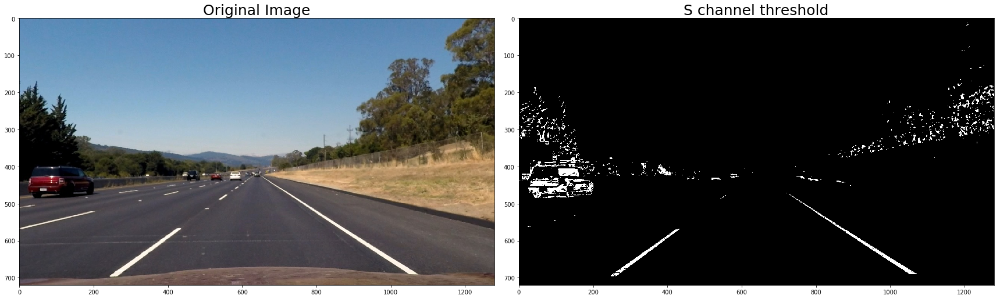

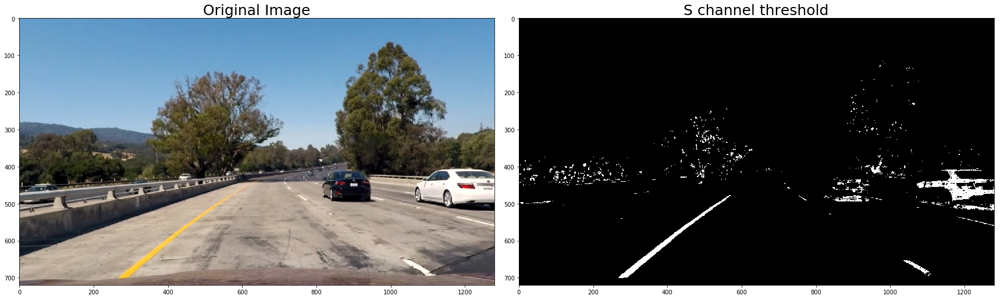

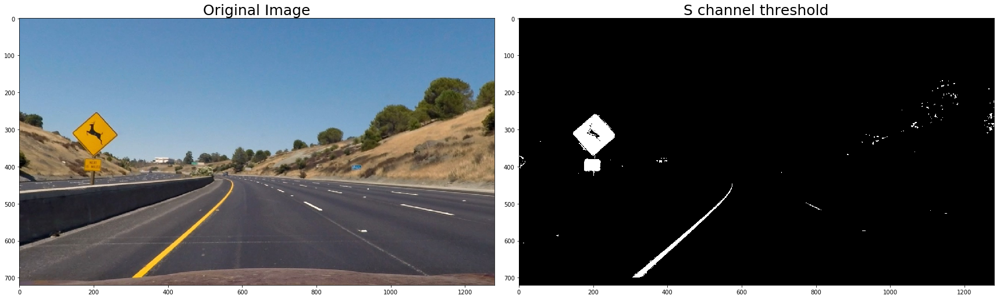

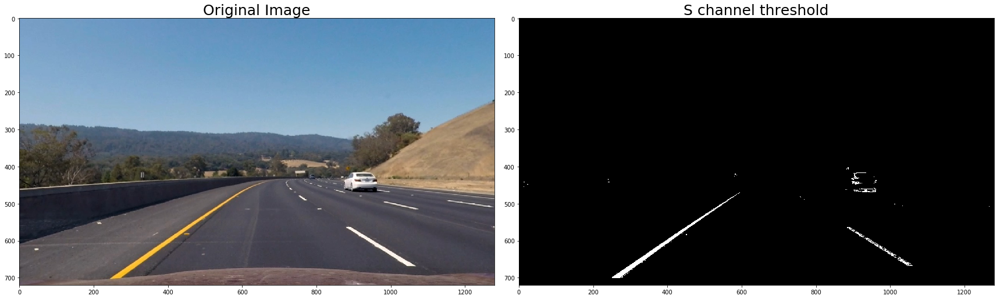

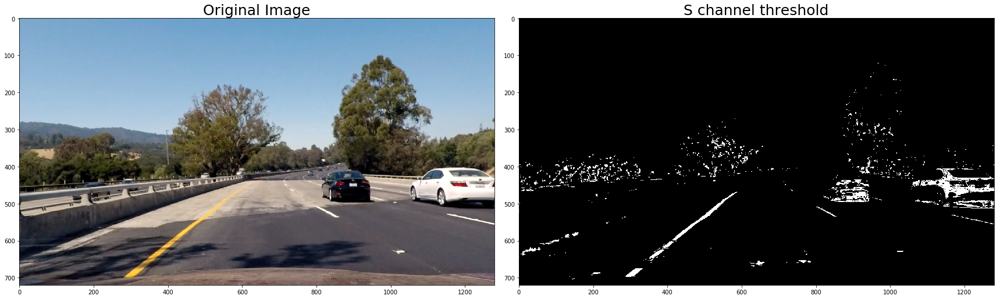

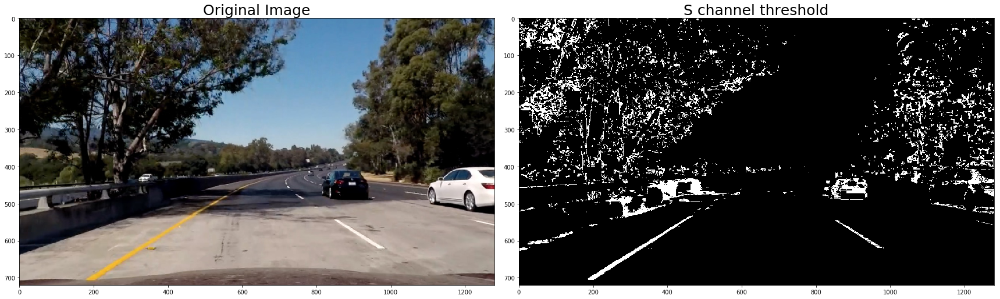

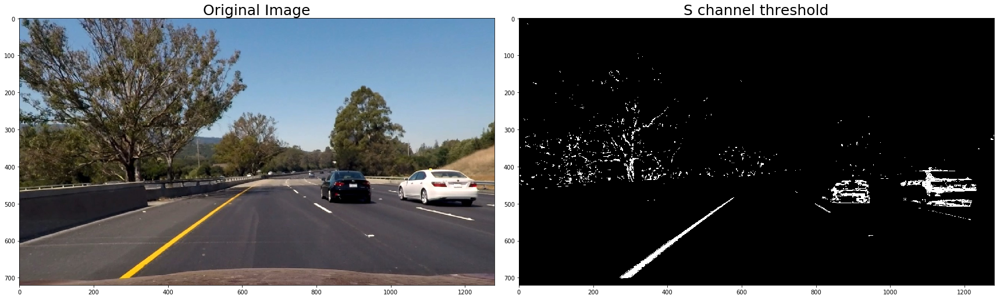

In [7]:
def s_channel_thr(image, thresh=(170, 255)):
    hsv = cv2.cvtColor(image, cv2.COLOR_RGB2HLS).astype(np.float)
    s_channel = hsv[:,:,2]
    # Threshold color channel
    s_binary = np.zeros_like(s_channel)
    s_binary[(s_channel >= thresh[0]) & (s_channel <= thresh[1])] = 1
    return s_binary

for img in undistorted_test_images:
    # Threshold s channel
    s_binary = s_channel_thr(img, thresh=(170, 255))
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(s_binary, cmap='gray')
    ax2.set_title('S channel threshold', fontsize=25)

Combine all findings and create a pipeline producing the final binary

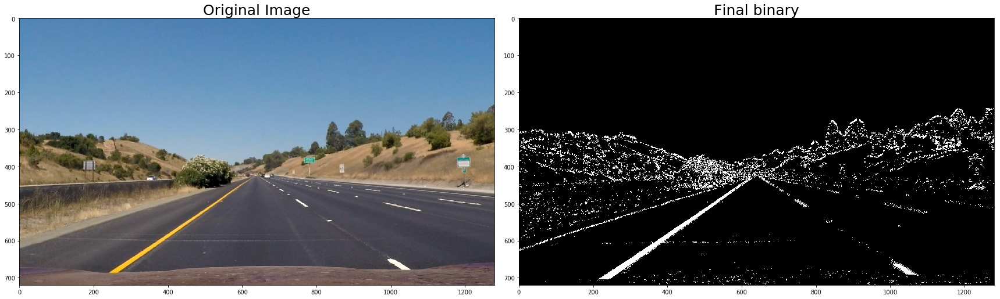

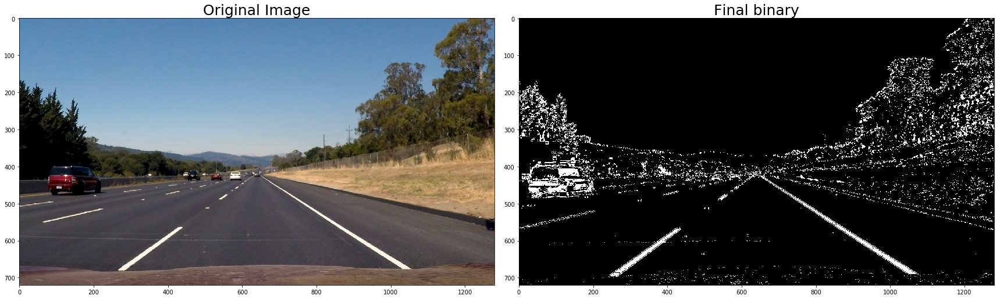

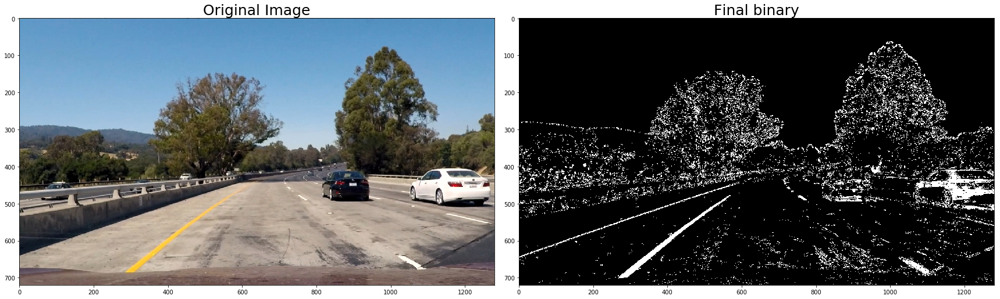

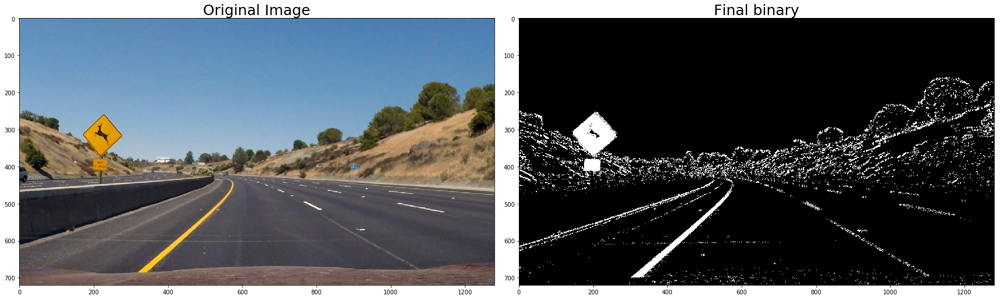

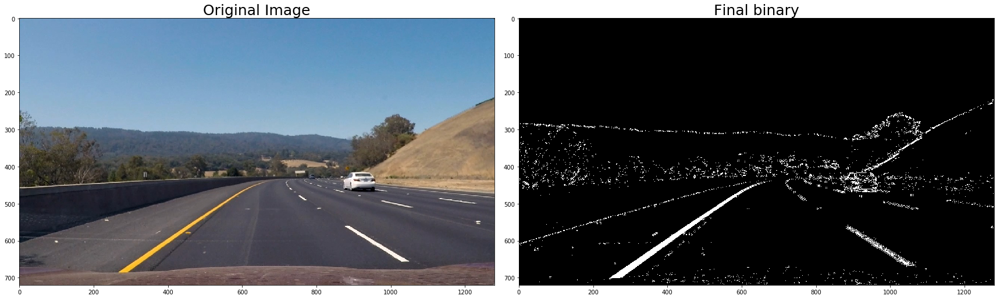

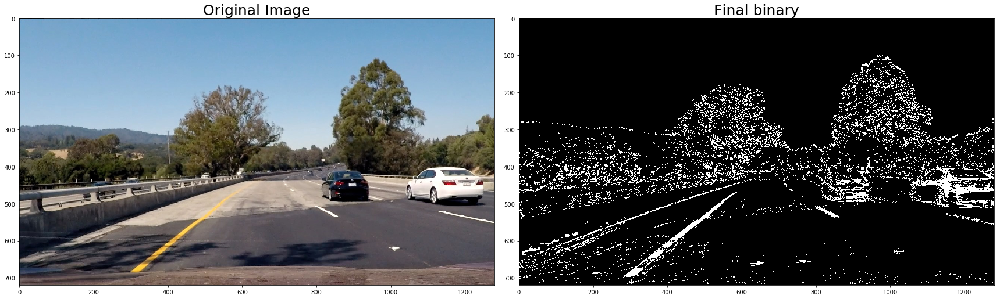

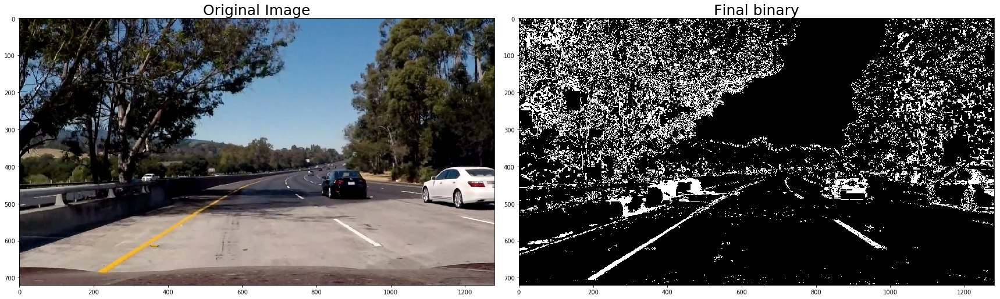

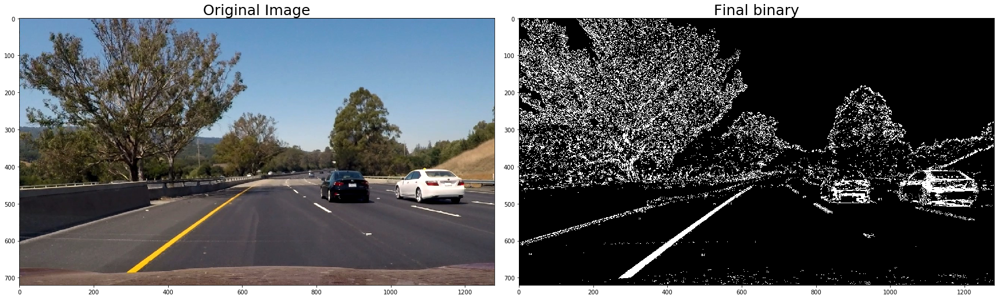

In [8]:
def bin_combined(img):
    # Binarize image using to s channel
    s_binary = s_channel_thr(img)
    # Binarize image using grad combined thresholds
    grad_comb = grad_combined(img,sobel_kernel=3)
    # Combine the two binary thresholds
    combined_binary = np.zeros_like(s_binary)
    combined_binary[(s_binary == 1) | (grad_comb == 1)] = 1
    return combined_binary

for img_path in test_image_list:
    img = cv2.imread(img_path)
    # Undistort images
    undistorted = cv2.undistort(img, mtx, dist, None, mtx)
    # Get final binary image
    binary = bin_combined(undistorted)
    # Plot the result
    f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
    f.tight_layout()
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    ax1.imshow(img)
    ax1.set_title('Original Image', fontsize=25)
    ax2.imshow(binary, cmap='gray')
    ax2.set_title('Final binary', fontsize=25)
    f.savefig('output_images/final binary images/'+img_path.split('\\')[-1].split('.')[0]+'_final_binary.jpg')
    

Apply perspective transform. Identify manually the source and destination points and correct them accordingly

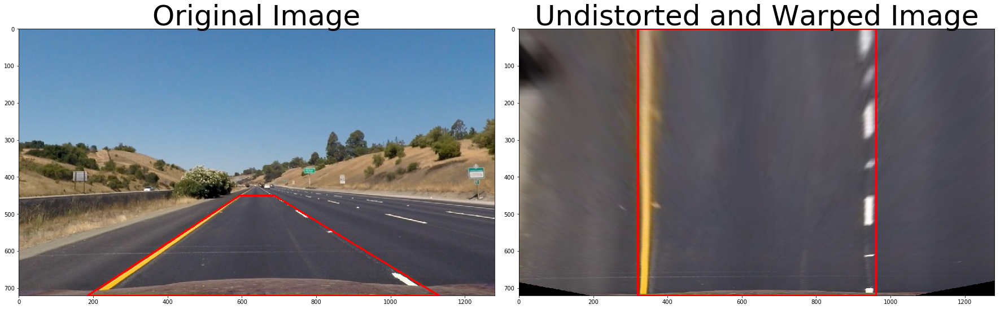

In [9]:
# The source points
src = np.float32(
    [[593,450],
     [688,450],
     [1130,720],
     [185,720]])
# The destination points
dst = np.float32(
    [[320,0],
     [960,0],
     [960,720],
     [320,720]])
nx = 9 # Number of columns
ny = 6 # Number of rows

def corners_unwarp(img, mtx, dist, src_points, dst_points):
    img_size = (img.shape[1],img.shape[0])
    # Undistort
    #undst = cv2.undistort(img, mtx, dist, None, mtx)
    # Calculate perspective transform matrix
    M = cv2.getPerspectiveTransform(src, dst)
    # Calculate inverse perspective transform matrix
    Minv = cv2.getPerspectiveTransform(dst, src)
    # Get the warped image
    warped = cv2.warpPerspective(img, M, img_size, flags=cv2.INTER_LINEAR)
    return warped, M, Minv


# Read in the saved camera matrix and distortion coefficients
dist_pickle = pickle.load( open( "output_images/wide_dist_pickle.p", "rb" ) )
mtx = dist_pickle["mtx"]
dist = dist_pickle["dist"]
# Transform points to draw lines
pts_src = np.asarray(src).astype(int)  
pts_dst = np.asarray(dst).astype(int) 

# Show lines and calibrate image
img_path = test_image_list[0]
img = cv2.imread(img_path)
img = cv2.undistort(img, mtx, dist, None, mtx)
top_down, perspective_M, inv_perspective_M = corners_unwarp(img, mtx, dist, src,dst)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
s_img = cv2.polylines(img,[pts_src],True,(255,0,0), thickness=3,)   
top_down = cv2.cvtColor(top_down, cv2.COLOR_BGR2RGB)
d_img = cv2.polylines(top_down,[pts_dst],True,(255,0,0), thickness=3,)
ax1.imshow(s_img)
ax1.set_title('Original Image', fontsize=50)
ax2.imshow(d_img)
ax2.set_title('Undistorted and Warped Image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)
plt.savefig('output_images/undist_test_image_with_points.jpg')

Visualize inital binary and warped binary image

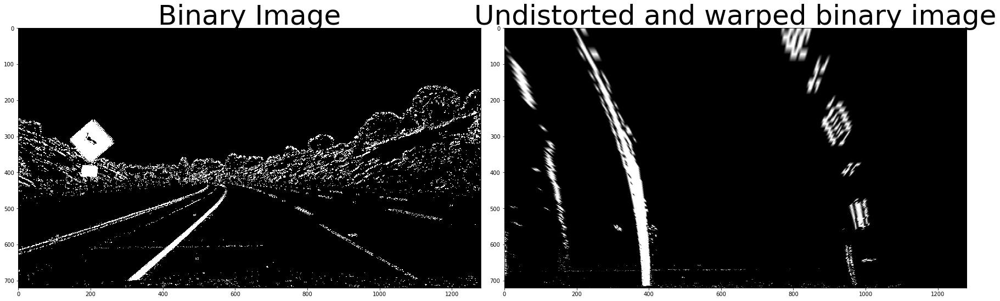

In [10]:
img = cv2.imread(test_image_list[3])
img = cv2.undistort(img, mtx, dist, None, mtx)
binary = bin_combined(img)
top_down, perspective_M, inv_perspective_M = corners_unwarp(binary, mtx, dist, src,dst)
f, (ax1, ax2) = plt.subplots(1, 2, figsize=(24, 9))
f.tight_layout()
ax1.imshow(binary, cmap='gray')
ax1.set_title('Binary Image', fontsize=50)
ax2.imshow(top_down, cmap='gray')
ax2.set_title('Undistorted and warped binary image', fontsize=50)
plt.subplots_adjust(left=0., right=1, top=0.9, bottom=0.)

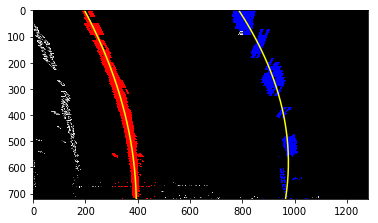

In [11]:
def find_lane_lines(binary_warped):
    # Assuming you have created a warped binary image called "binary_warped"
    # Take a histogram of the bottom half of the image
    histogram = np.sum(binary_warped[binary_warped.shape[0]/2:,:], axis=0)
    # Create an output image to draw on and  visualize the result
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    # Find the peak of the left and right halves of the histogram
    # These will be the starting point for the left and right lines
    midpoint = np.int(histogram.shape[0]/2)
    leftx_base = np.argmax(histogram[:midpoint])
    rightx_base = np.argmax(histogram[midpoint:]) + midpoint

    # Choose the number of sliding windows
    nwindows = 9
    # Set height of windows
    window_height = np.int(binary_warped.shape[0]/nwindows)
    # Identify the x and y positions of all nonzero pixels in the image
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    # Current positions to be updated for each window
    leftx_current = leftx_base
    rightx_current = rightx_base
    # Set the width of the windows +/- margin
    margin = 100
    # Set minimum number of pixels found to recenter window
    minpix = 50
    # Create empty lists to receive left and right lane pixel indices
    left_lane_inds = []
    right_lane_inds = []

    # Step through the windows one by one
    for window in range(nwindows):
        # Identify window boundaries in x and y (and right and left)
        win_y_low = binary_warped.shape[0] - (window+1)*window_height
        win_y_high = binary_warped.shape[0] - window*window_height
        win_xleft_low = leftx_current - margin
        win_xleft_high = leftx_current + margin
        win_xright_low = rightx_current - margin
        win_xright_high = rightx_current + margin
        # Draw the windows on the visualization image
        cv2.rectangle(out_img,(win_xleft_low,win_y_low),(win_xleft_high,win_y_high),(0,255,0), 2) 
        cv2.rectangle(out_img,(win_xright_low,win_y_low),(win_xright_high,win_y_high),(0,255,0), 2) 
        # Identify the nonzero pixels in x and y within the window
        good_left_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xleft_low) & (nonzerox < win_xleft_high)).nonzero()[0]
        good_right_inds = ((nonzeroy >= win_y_low) & (nonzeroy < win_y_high) & (nonzerox >= win_xright_low) & (nonzerox < win_xright_high)).nonzero()[0]
        # Append these indices to the lists
        left_lane_inds.append(good_left_inds)
        right_lane_inds.append(good_right_inds)
        # If you found > minpix pixels, recenter next window on their mean position
        if len(good_left_inds) > minpix:
            leftx_current = np.int(np.mean(nonzerox[good_left_inds]))
        if len(good_right_inds) > minpix:        
            rightx_current = np.int(np.mean(nonzerox[good_right_inds]))

    # Concatenate the arrays of indices
    left_lane_inds = np.concatenate(left_lane_inds)
    right_lane_inds = np.concatenate(right_lane_inds)

    # Extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds] 

    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    
    # Generate x and y values for plotting
    #ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    #left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    #right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    #out_img[nonzeroy[left_lane_inds], nonzerox[left_lane_inds]] = [255, 0, 0]
    #out_img[nonzeroy[right_lane_inds], nonzerox[right_lane_inds]] = [0, 0, 255]
    
    return leftx,lefty,rightx,righty, left_fit, right_fit

def visualize_polyfit(warped_binary,leftx,lefty,rightx,righty, left_fit, right_fit):
    out_img = np.dstack((warped_binary, warped_binary, warped_binary))*255
    ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    out_img[lefty, leftx] = [1, 0, 0]
    out_img[righty, rightx] = [0, 0, 1]
    #fig = figure()
    return out_img

leftx,lefty,rightx,righty, left_fit, right_fit = find_lane_lines(top_down)
out_img = visualize_polyfit(top_down,leftx,lefty,rightx,righty, left_fit, right_fit)
# Create y and x dta for plotting fitting lines
ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

fig = plt.figure(1)
plt.imshow(out_img)
plt.plot(left_fitx, ploty, right_fitx, ploty,color='yellow')
#plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)
plt.savefig('output_images/find_lale_lines_hist_fitting.jpg')

(720, 0)

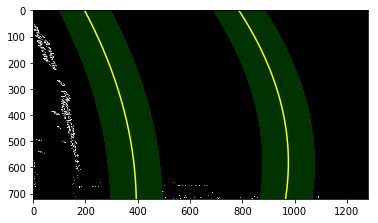

In [12]:
def find_lane_lines_fast(binary_warped, left_fit, right_fit):
    # Assume you now have a new warped binary image 
    # from the next frame of video (also called "binary_warped")
    # It's now much easier to find line pixels!
    nonzero = binary_warped.nonzero()
    nonzeroy = np.array(nonzero[0])
    nonzerox = np.array(nonzero[1])
    margin = 100
    left_lane_inds = ((nonzerox > (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] - margin)) & (nonzerox < (left_fit[0]*(nonzeroy**2) + left_fit[1]*nonzeroy + left_fit[2] + margin))) 
    right_lane_inds = ((nonzerox > (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] - margin)) & (nonzerox < (right_fit[0]*(nonzeroy**2) + right_fit[1]*nonzeroy + right_fit[2] + margin)))  

    # Again, extract left and right line pixel positions
    leftx = nonzerox[left_lane_inds]
    lefty = nonzeroy[left_lane_inds] 
    rightx = nonzerox[right_lane_inds]
    righty = nonzeroy[right_lane_inds]
    # Fit a second order polynomial to each
    left_fit = np.polyfit(lefty, leftx, 2)
    right_fit = np.polyfit(righty, rightx, 2)
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
    
    return leftx,lefty,rightx,righty, left_fit, right_fit, margin


def visualize_polyfit_search_area(binary_warped, leftx,lefty,rightx,righty, left_fit, right_fit, margin):
    # Create an image to draw on and an image to show the selection window
    out_img = np.dstack((binary_warped, binary_warped, binary_warped))*255
    window_img = np.zeros_like(out_img)
    # Color in left and right line pixels
    out_img[lefty, leftx] = [255, 0, 0]
    out_img[righty, rightx] = [0, 0, 255]
    
    # Generate x and y values for plotting
    ploty = np.linspace(0, binary_warped.shape[0]-1, binary_warped.shape[0] )
    left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Generate a polygon to illustrate the search window area
    # And recast the x and y points into usable format for cv2.fillPoly()
    left_line_window1 = np.array([np.transpose(np.vstack([left_fitx-margin, ploty]))])
    left_line_window2 = np.array([np.flipud(np.transpose(np.vstack([left_fitx+margin, ploty])))])
    left_line_pts = np.hstack((left_line_window1, left_line_window2))
    right_line_window1 = np.array([np.transpose(np.vstack([right_fitx-margin, ploty]))])
    right_line_window2 = np.array([np.flipud(np.transpose(np.vstack([right_fitx+margin, ploty])))])
    right_line_pts = np.hstack((right_line_window1, right_line_window2))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(window_img, np.int_([left_line_pts]), (0,255, 0))
    cv2.fillPoly(window_img, np.int_([right_line_pts]), (0,255, 0))
    result = cv2.addWeighted(out_img, 1, window_img, 0.3, 0)
    
    return result


leftx,lefty,rightx,righty, left_fit, right_fit, margin = find_lane_lines_fast(top_down, left_fit, right_fit)

result = visualize_polyfit_search_area(top_down, leftx,lefty,rightx,righty, left_fit, right_fit, margin)
plt.imshow(result)
plt.plot(left_fitx, ploty, color='yellow')
plt.plot(right_fitx, ploty, color='yellow')
plt.xlim(0, 1280)
plt.ylim(720, 0)

In [13]:
def find_curvature(left_fit, right_fit):
    ploty = np.linspace(0, 719, num=720)
    y_eval = np.max(ploty)
    
    leftx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
    rightx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]

    # Define conversions in x and y from pixels space to meters
    ym_per_pix = 30/720 # meters per pixel in y dimension
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    
    img_width = 1280*xm_per_pix
    img_height = 720*ym_per_pix
    
    # Fit new polynomials to x,y in world space
    left_fit_cr = np.polyfit(ploty*ym_per_pix, leftx*xm_per_pix, 2)
    right_fit_cr = np.polyfit(ploty*ym_per_pix, rightx*xm_per_pix, 2)
    # Calculate the new radii of curvature
    
    left_curverad = ((1 + (2*left_fit_cr[0]*img_height + left_fit_cr[1])**2)**1.5) / np.absolute(2*left_fit_cr[0])
    right_curverad = ((1 + (2*right_fit_cr[0]*img_height + right_fit_cr[1])**2)**1.5) / np.absolute(2*right_fit_cr[0])
    
    return round(left_curverad,1), round(right_curverad,1)

left_curverad, right_curverad = find_curvature(left_fit, right_fit)
print (left_curverad, right_curverad)

def find_offset_from_center(image,left_fitx,right_fitx):
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    lanes_center = (left_fitx[-1] + right_fitx[-1])/2.0
    image_center = image.shape[1]/2.0
    offset = (image_center - lanes_center)*xm_per_pix # Positive on right, Negative on left
    return round(offset,1)

dist_offset = find_offset_from_center(img,left_fitx,right_fitx)
print (dist_offset)

def lanes_distance(left_fitx,right_fitx):
    xm_per_pix = 3.7/700 # meters per pixel in x dimension
    return (right_fitx[0] - left_fitx[0])*xm_per_pix

lane_distance = lanes_distance(left_fitx,right_fitx)
print (lane_distance)

472.0 294.7
-0.2
3.1180864029


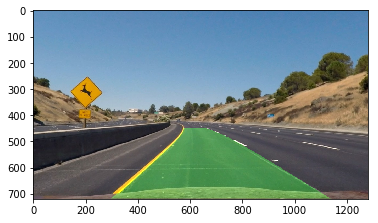

In [14]:
def draw_lane_lines(img, warped, Minv,  left_fitx, right_fitx):
    ploty = np.linspace(0, 719, num=720)
    left_fitx = left_fitx[0]*ploty**2 + left_fitx[1]*ploty + left_fitx[2]
    right_fitx = right_fitx[0]*ploty**2 + right_fitx[1]*ploty + right_fitx[2]
    
    # Create an image to draw the lines on
    warp_zero = np.zeros_like(warped).astype(np.uint8)
    color_warp = np.dstack((warp_zero, warp_zero, warp_zero))

    # Recast the x and y points into usable format for cv2.fillPoly()
    pts_left = np.array([np.transpose(np.vstack([left_fitx, ploty]))])
    pts_right = np.array([np.flipud(np.transpose(np.vstack([right_fitx, ploty])))])
    pts = np.hstack((pts_left, pts_right))

    # Draw the lane onto the warped blank image
    cv2.fillPoly(color_warp, np.int_([pts]), (0,255, 0))

    # Warp the blank back to original image space using inverse perspective matrix (Minv)
    newwarp = cv2.warpPerspective(color_warp, Minv, (img.shape[1], img.shape[0])) 
    # Combine the result with the original image
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
    result = cv2.addWeighted(img, 1, newwarp, 0.3, 0)
    return result

#img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
output = draw_lane_lines(img, top_down, inv_perspective_M, left_fit, right_fit)
plt.imshow(output)
plt.savefig('output_images/draw_lanes_example_image.jpg')

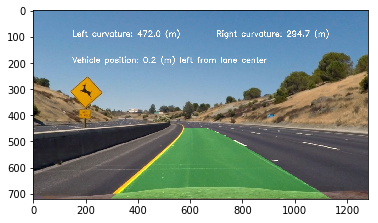

In [15]:
def add_text(img,left_curverad, right_curverad, lane_offset):
    n_img = img.copy()
    font = cv2.FONT_HERSHEY_SIMPLEX
    cv2.putText(n_img,'Left curvature: %s (m)'%left_curverad,(150,100), font, 1,(255,255,255),2,cv2.LINE_AA)
    cv2.putText(n_img,'Right curvature: %s (m)'%right_curverad,(700,100), font, 1,(255,255,255),2,cv2.LINE_AA)
    offset_text = 'Vehicle position: %s (m) right from lane center'%abs(lane_offset) if lane_offset>=0 else 'Vehicle position: %s (m) left from lane center'%abs(lane_offset)
    cv2.putText(n_img,offset_text,(150,200), font, 1,(255,255,255),2,cv2.LINE_AA)
    return n_img

text_output = add_text(output,left_curverad, right_curverad, dist_offset)
plt.imshow(text_output)

In [16]:
import collections

ym_per_pix = 30/720 # meters per pixel in y dimension
xm_per_pix = 3.7/700 # meteres per pixel in x dimension

# The source points
src = np.float32([[593,450], [688,450], [1130,720], [185,720]])
# The destination points
dst = np.float32([[320,0], [960,0], [960,720], [320,720]])

# Define a class to receive the characteristics of each line detection
class Line():
    def __init__(self, n_fits_cache):
        # was the line detected in the last iteration?
        self.detected = False  
        # x values of the last n fits of the line
        self.recent_xfitted = collections.deque(maxlen=n_fits_cache)
        self.recent_yfitted = collections.deque(maxlen=n_fits_cache)
        # coefficient values of the last n fits of the line
        self.recent_fitted = collections.deque(maxlen=n_fits_cache)
        #average x values of the fitted line over the last n iterations
        self.bestx = None     
        #polynomial coefficients averaged over the last n iterations
        self.best_fit = None  
        #polynomial coefficients for the most recent fit
        self.current_fit = [np.array([False])]  
        #radius of curvature of the line in some units
        self.radius_of_curvature = None 
        #distance in meters of vehicle center from the line
        self.line_base_pos = None 
        #difference in fit coefficients between last and new fits
        self.diffs = np.array([0,0,0], dtype='float') 
        #x values for detected line pixels
        self.allx = None  
        #y values for detected line pixels
        self.ally = None
        self.current_xfit = None
        self.current_ploty = None
        self.failed_detections = 0
        
    def calc_lane_curvature(self):
        fit = self.best_fit if self.best_fit is not None else self.current_fit
        if fit is None:
            return None
        ploty = np.linspace(0, 719, num=720)
        y_eval = np.max(ploty)    
        x = fit[0]*ploty**2 + fit[1]*ploty + fit[2]
        # Define conversions in x and y from pixels space to meters
        ym_per_pix = 30/720 # meters per pixel in y dimension
        xm_per_pix = 3.7/700 # meters per pixel in x dimension    
        img_width = 1280*xm_per_pix
        img_height = 720*ym_per_pix    
        # Fit new polynomials to x,y in world space
        fit_cr = np.polyfit(ploty*ym_per_pix, x*xm_per_pix, 2)        
        # Calculate the new radii of curvature    
        curverad = ((1 + (2*fit_cr[0]*img_height + fit_cr[1])**2)**1.5) / np.absolute(2*fit_cr[0])
        final_curve = round(curverad,1)
        # Set curvature value
        self.radius_of_curvature = final_curve
        return final_curve
    
    def add_fit_coef(self):
        self.recent_fitted.append(self.current_fit)
        self.best_fit = np.mean(self.recent_fitted, axis=0)
        
    def add_fitx_coef(self):
        self.recent_xfitted.append(self.current_xfit)
        self.bestx = np.mean(self.recent_xfitted, axis=0)
        
    def reset_fit(self):
        self.recent_fitted.clear()
        self.recent_xfitted.clear()
        self.bestx = None     
        self.best_fit = None
        self.radius_of_curvature = None 

def sanity_check(left_lane,right_lane):
    if lanes_distance(left_lane.current_xfit,right_lane.current_xfit) > 3.7 :
        return False
    else:
        return True
    #curve_tolerance = 0.10
    #curve_difference = abs(left_lane.radius_of_curvature - right_lane.radius_of_curvature)/((left_lane.radius_of_curvature + right_lane.radius_of_curvature)/2.0)
    #if curve_difference > curve_tolerance:
    #    return False
    #else:
    #    return True
 

def update_lane(lane,ploty,fit,fitx):
    lane.current_xfit = fitx
    lane.current_ploty = ploty
    lane.current_fit = fit
    return lane

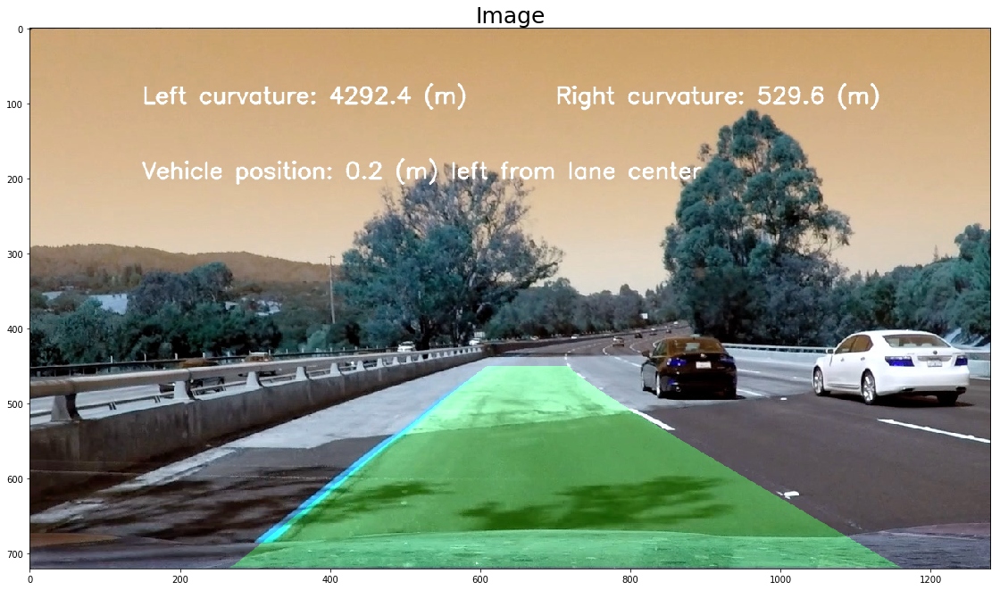

In [18]:
import collections
from itertools import repeat


def process_image(image,cache_frames_length = 10, failed_detections_tolerance = 3 ):
    global nx, ny, mtx, dist, src,dst
        
    if process_image.global_cache is None:
        left_lane = Line(n_fits_cache = cache_frames_length)
        right_lane = Line(n_fits_cache = cache_frames_length)        
        global_cache= {
            'left_lane': left_lane,
            'right_lane': right_lane,
        }        
    else:
        global_cache = process_image.global_cache
        left_lane = global_cache['left_lane']
        right_lane = global_cache['right_lane']
        
    # Convert to RGB
    image = cv2.cvtColor(image, cv2.COLOR_BGR2RGB)
    # Undistort image
    undistorted = cv2.undistort(image, mtx, dist, None, mtx)
    # Compute binary
    binary = bin_combined(undistorted)
    # Get warped image in bird's eye view
    birds_eye, perspective_M, inv_perspective_M = corners_unwarp(binary, mtx, dist, src,dst)
    
    reseted = False
    
    if ((left_lane.current_xfit is None or left_lane.failed_detections > failed_detections_tolerance) 
            or (right_lane.current_xfit is None or right_lane.failed_detections > failed_detections_tolerance)):
        # Reset values
        #left_lane.reset_fit()
        #right_lane.reset_fit()
        reseted = True
        # Detect from scratch
        #ploty, left_fitx, right_fitx, left_fit, right_fit, warped = find_lane_lines(birds_eye)
        leftx,lefty,rightx,righty, left_fit, right_fit = find_lane_lines(birds_eye)
        ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
        update_lane(left_lane,ploty,left_fit,left_fitx)
        update_lane(right_lane,ploty,right_fit,right_fitx) 
        #print ("hist")
        #result = visualize_polyfit(birds_eye,leftx,lefty,rightx,righty, left_fit, right_fit)                
    else:
        # Detect based on previous findings (Fast)
        #ploty, left_fitx, right_fitx, left_fit, right_fit, warped = find_lane_lines_fast(birds_eye, left_lane.best_fit, right_lane.best_fit)
        leftx,lefty,rightx,righty, left_fit, right_fit, margin = find_lane_lines_fast(birds_eye, left_lane.best_fit, right_lane.best_fit)
        ploty = np.linspace(0, out_img.shape[0]-1, out_img.shape[0] )
        left_fitx = left_fit[0]*ploty**2 + left_fit[1]*ploty + left_fit[2]
        right_fitx = right_fit[0]*ploty**2 + right_fit[1]*ploty + right_fit[2]
        
        update_lane(left_lane,ploty,left_fit,left_fitx)
        update_lane(right_lane,ploty,right_fit,right_fitx)
        
        #result = visualize_polyfit_search_area(birds_eye, leftx,lefty,rightx,righty, left_fit, right_fit, margin)
     
    # Calculate lane curvature
    left_lane.calc_lane_curvature()
    right_lane.calc_lane_curvature()
    
    if sanity_check(left_lane,right_lane) or left_lane.best_fit is None : # If lanes are the correct ones:
        # Set appropriate flags
        left_lane.failed_detections = 0
        right_lane.failed_detections = 0
        left_lane.detected = True
        right_lane.detected = True
        # Update fit coef best values
        left_lane.add_fit_coef()
        right_lane.add_fit_coef()
        # Update fitx coef best values
        left_lane.add_fitx_coef()
        right_lane.add_fitx_coef()

    else:
        left_lane.failed_detections += 1
        right_lane.failed_detections += 1
        left_lane.detected = False
        right_lane.detected = False
    
    # Store lanes for processing next frame
    global_cache['left_lane'] = left_lane
    global_cache['right_lane'] = right_lane    
    process_image.global_cache = global_cache
    
    # Draw lane lines
    result = draw_lane_lines(image, birds_eye, inv_perspective_M, left_lane.best_fit, right_lane.best_fit)
    
    # Compute distance between center of car and center of lanes
    dist_offset = find_offset_from_center(image,left_lane.bestx,right_lane.bestx)
    # Add text in image
    output = add_text(result,left_lane.radius_of_curvature, right_lane.radius_of_curvature, dist_offset)
    return output

def clear_cache():
    process_image.global_cache = None

clear_cache()
img_path = test_image_list[5]
img = cv2.imread(img_path)
final_image = process_image(img)
# Plot the result
f, (ax1) = plt.subplots(1, 1, figsize=(24, 9))
f.tight_layout()

ax1.imshow(final_image)
ax1.set_title('Image', fontsize=25)

In [19]:
clear_cache()
vid_output = 'project_video_result.mp4'
project_video = VideoFileClip('project_video.mp4')
result_video = project_video.fl_image(process_image)
result_video.write_videofile(vid_output, audio=False)

[MoviePy] >>>> Building video project_video_result.mp4
[MoviePy] Writing video project_video_result.mp4


100%|█████████████████████████████████████▉| 1260/1261 [07:52<00:00,  2.55it/s]


[MoviePy] Done.
[MoviePy] >>>> Video ready: project_video_result.mp4 

